# Computer Vision - P2

## Delivery

Up to **1 point out of 10** will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented.

- The questions introduced in the exercises must be answered.

- Comments need to be in **english**.

- The deliverable must be a file named **P2_Student1_Student2.zip** that includes:
    - The notebook P2_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook.

**Deadline (Campus Virtual): October 24th, 23:00 h** 

==============================================================================================
## Practicum 2: Filtering and edge detection

==============================================================================================

The main topics are:
1. Image smoothing and convolution (exercises 2.1, 2.2, 2.3 and 2.4)
2. Edge detection (exercises 2.5, 2.6 and 2.7)

In order to complete this practicum, the following concepts need to be understood: linear filters, histograms, convolutions, and edges.

The following chapters of the book "Computer Vision: Algorithms and Applications" by Richard Szeliski provide additional information:
* Chapter 3. Image processing: Point operators & linear filtering.
* Chapter 4. Feature detection and matching: Edges.

### 2.1 RGB histogram visualization

a) Read the image `./images_notebook/rocki.jpeg` and visualize the RGB image as well as each of its channels separately (R, G, and B). Print the image shape and data type.

<img src="images_notebook/rocki.jpeg" width="400" height="400">

**Note:** Before applying the histogram, you should pass the image into float.

Image shape: (1024, 768, 3)
Image data type: uint8


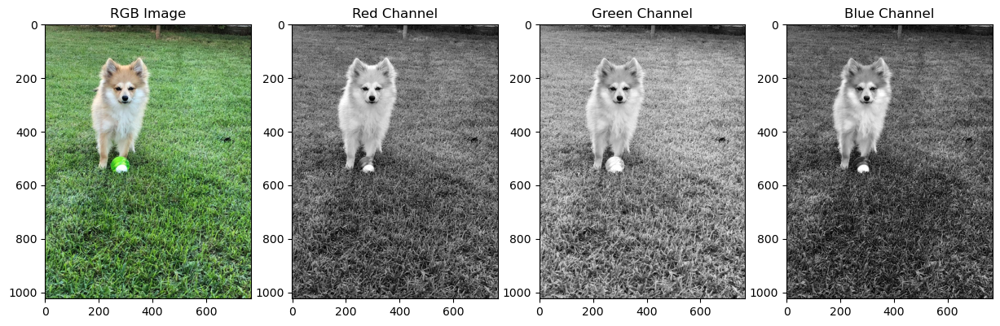

In [32]:
# Your solution

# Import libraries
from skimage import io
import matplotlib.pyplot as plt

# Read the image 
rocki = io.imread('images_notebook/rocki.jpeg')

# Print the shape and data type of the image
print('Image shape:', rocki.shape)
print('Image data type:', rocki.dtype)

# Visualize the RGB image as well as each channel separately
plt.figure(figsize=(15,15))

plt.subplot(1,4,1)
plt.imshow(rocki)
plt.title('RGB Image')

plt.subplot(1,4,2)
plt.imshow(rocki[:,:,0],cmap='gray')
plt.title('Red Channel')

plt.subplot(1,4,3)
plt.imshow(rocki[:,:,1],cmap='gray')
plt.title('Green Channel')

plt.subplot(1,4,4)
plt.imshow(rocki[:,:,2],cmap='gray')
plt.title('Blue Channel')

plt.show()

b) Make a function `im_hist(im,  nbins=8)` to visualize the histogram of the RGB, and grayscale images. What is the histogram representing for an image? 

The plotted histogram must accomplish these requirements (see image bellow as an example of histogram extraction):

- Obtain the histogram with 16, 32, 64 and 256 bins. What are the bins representing?

- Visualize the histogram of each channel and the gray level image separately and compare them. Comment their differences.

**Note:** What type should be the image in order to compute the histogram? Check using different bins for the histogram. 

**Hint** : the `exposure` module within the `skimage` library makes the histogram extraction easy!

**Help:** [matplotlib image tutorial](https://matplotlib.org/users/image_tutorial.html)

<img src='images_notebook/histograms.png'>

<img src='images_notebook/histograms2.png'>

<img src='images_notebook/histograms3.png'>

# Answers to the previous questions

**1. What is the histogram representing for an image?**

A histogram for an image represents the distribution of pixel intensities in an image. For color images, we can compute histograms for each of the channels (R, G, B) separately. A histogram tells us about the contrast, brightness, and intensity distribution of an image. It provides insights into the characteristics of the image such as its brightness, contrast, and the presence of specific colors.

**2. Obtain the histogram with 16, 32, 64 and 256 bins. What are the bins representing?**

Bins in a histogram represent the range of pixel values. The pixel values in an image (for an 8-bit image) range from 0 to 255. If we choose 256 bins, each bin corresponds to a single pixel value. If we choose 8 bins, then each bin would represent a range of 256/8 = 32 pixel values. For 16 bins, each bin would cover a range of 16 pixel values, for 32 bins each bin covers 8 pixel values, and for 64 bins, each bin covers 4 pixel values. The fewer the bins, the more values each bin represents, which means the histogram becomes more general or coarser.

**3. Visualize the histogram of each channel and the gray level image separately and compare them. Comment on their differences.**

From the histograms:

- The grayscale histogram provides a summarized view of the pixel intensity distribution, regardless of the color.

- The RGB histograms show the distribution of pixel intensities for each color channel separately. This means we can understand how intensities of each color (Red, Green, and Blue) are distributed in the image.

- By comparing the histograms, we can observe which colors are more dominant or prevalent in the image. If one color channel has higher peaks than the others, it means that particular color is more dominant in the image.

- The distribution in the grayscale histogram is the result of a combination of the RGB channels, so it won't favor any particular color but instead show the overall brightness distribution.

**4. Note: What type should be the image in order to compute the histogram? Check using different bins for the histogram.**

To compute a histogram, the image should have defined pixel intensity values. This means grayscale images or RGB images can have histograms. However, the datatype matters. If you're working with an image library that reads images as integers (values between 0 and 255), then the histogram should be computed directly. If the image is read as floats (values between 0 and 1, as is the case with some image processing libraries), you'd want to scale them to the 0-255 range, as done in the provided code.

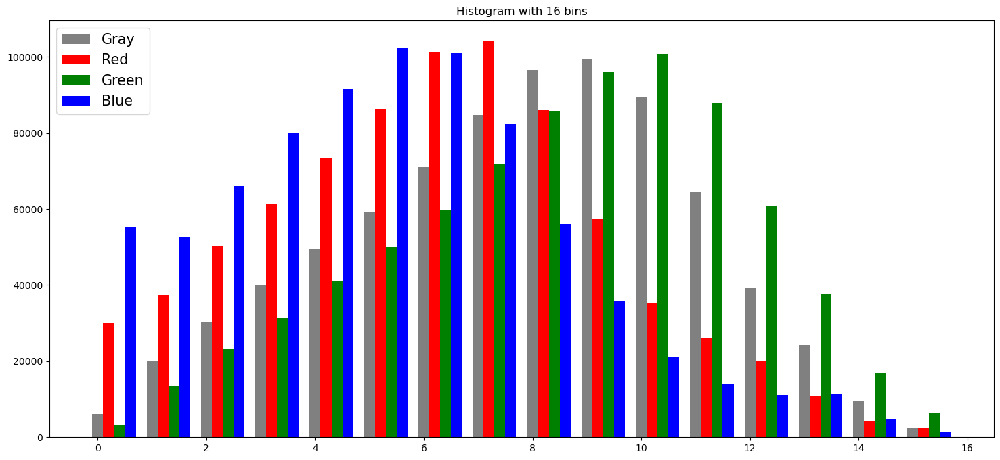

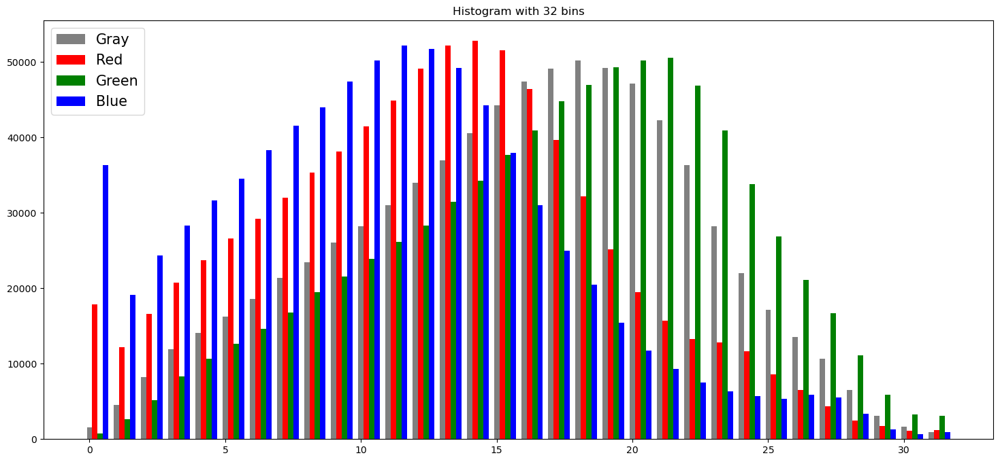

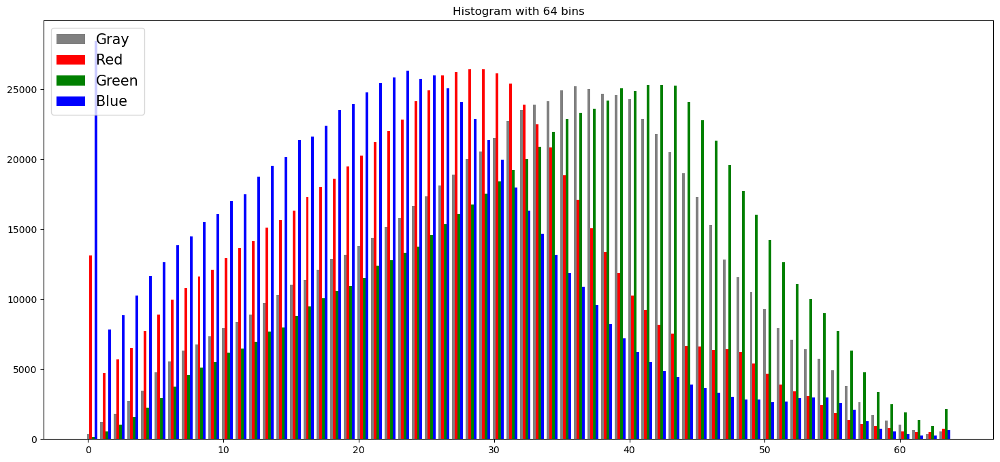

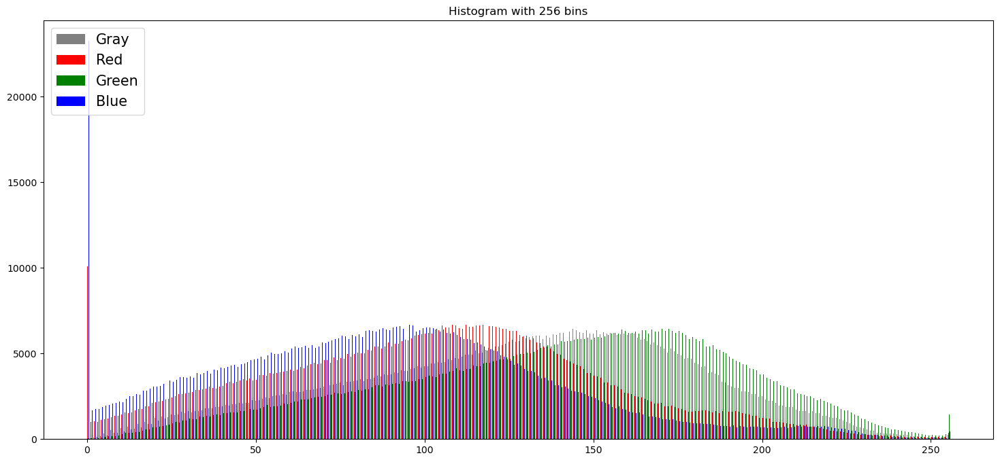

In [33]:
# Your solution

import matplotlib.pyplot as plt
import numpy as np
from skimage.io import imread
from skimage.exposure import histogram
from skimage import img_as_float
from skimage.color import rgb2gray

# Function to plot the histogram
def im_hist(im, nbins=8):
    # Convert image to float
    im_float = img_as_float(im) * 255
    gray_image = rgb2gray(im_float)

    # Compute histograms
    hst_gray, _ = histogram(gray_image, nbins=nbins)
    hst_r, _ = histogram(im_float[:,:,0], nbins=nbins)
    hst_g, _ = histogram(im_float[:,:,1], nbins=nbins)
    hst_b, _ = histogram(im_float[:,:,2], nbins=nbins)

    ind = np.arange(nbins)  # the x locations for the groups
    width = 0.2             # the width of the bars

    # Plotting
    fig = plt.figure(figsize=(18, 8))
    cl_gray = plt.bar(ind, hst_gray, width, color='gray')
    cl_r = plt.bar(ind+width, hst_r, width, color='r')
    cl_g = plt.bar(ind+2*width, hst_g, width, color='g')
    cl_b = plt.bar(ind+3*width, hst_b, width, color='b')
    
    plt.legend((cl_gray[0], cl_r[0], cl_g[0], cl_b[0]), ('Gray','Red','Green','Blue'), loc=2, prop={'size': 15})
    plt.title(f'Histogram with {nbins} bins')
    plt.show()

# Test the function
bins_values = [16, 32, 64, 256]
for bins in bins_values:
    im_hist(rocki, nbins=bins)

### 2.2 Grayscale and RGB images filtering (convolutions)

a) Read the image `./images_notebook/rocki.jpeg`. Reshape the image to $256x256$ pixels and convert to gray scale (i.e. `rocki_gray`). We are going to apply:

1. Convolve `rocki_gray` with a horizontal mask `mask_h1d=[[1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]]` using the function `ndimage.convolve()` of the package `scipy`.
2. Convolve `rocki_gray` with a transposed version of the mask in (2).
3. Convolve `rocki_gray` with a uniform `two-dimensional` mask of dimensions 15x15 with all values set to 1.

Check the maximum and minimum values, as well as the data type of each image.

- Is the type of the mask important for the convolution? What effect does each of the masks produce on the original image? Compare the results.


**Note:** The command `convolve` performs a multidimensional convolution! A vector should be represented as: [[1,...1]].

**Note:** Remember that before applying the `convolve` function the mask must be normalized (i.e. all values in the mask must sum 1).


# Answers to the questions

**1.Is the type of the mask important for the convolution?**

Yes, the mask (often referred to as a "kernel" or "filter" in the context of image processing) determines the nature of the operation performed on the image. Different masks can emphasize or suppress features in the image.

**2. What effect does each of the masks produce on the original image? Compare the results.**

- Horizontal Convolution (mask_h1d): This mask emphasizes horizontal changes in intensity, which can detect vertical lines or edges in the image.

- Vertical Convolution (mask_v1d): This mask emphasizes vertical changes in intensity, so it detects horizontal lines or edges in the image.

- 2D Convolution (mask_2d): The uniform 2D mask blurs the image, reducing its sharpness and noise. This is because it's essentially taking a local average around every pixel.

In essence, the 1D horizontal and vertical masks are edge detectors for vertical and horizontal edges respectively, while the 2D mask acts as a smoothing filter.

In [34]:
# Your solution

import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import resize
from scipy import ndimage

# 1. Read the image
rocki = imread('./images_notebook/rocki.jpeg')

# 2. Reshape it to 256x256 pixels
rocki_resized = resize(rocki, (256, 256))

# 3. Convert to grayscale
rocki_gray = rgb2gray(rocki_resized)

# Masks
mask_h1d = np.array([[1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]])
mask_h1d = mask_h1d / mask_h1d.sum()  # Normalize

mask_v1d = mask_h1d.T  # Transposed version of the mask

mask_2d = np.ones((15, 15))
mask_2d = mask_2d / mask_2d.sum()  # Normalize

# 4. Apply the convolutions
rocki_conv_h = ndimage.convolve(rocki_gray, mask_h1d)
rocki_conv_v = ndimage.convolve(rocki_gray, mask_v1d)
rocki_conv_2d = ndimage.convolve(rocki_gray, mask_2d)

# Check the max, min, and datatype of each image
print("Original Grayscale --> Max:", rocki_gray.max(), "Min:", rocki_gray.min(), "Type:", rocki_gray.dtype)
print("Horizontal Convolution --> Max:", rocki_conv_h.max(), "Min:", rocki_conv_h.min(), "Type:", rocki_conv_h.dtype)
print("Vertical Convolution --> Max:", rocki_conv_v.max(), "Min:", rocki_conv_v.min(), "Type:", rocki_conv_v.dtype)
print("2D Convolution --> Max:", rocki_conv_2d.max(), "Min:", rocki_conv_2d.min(), "Type:", rocki_conv_2d.dtype)

Original Grayscale --> Max: 0.9984100387463082 Min: 0.023950657045774957 Type: float64
Horizontal Convolution --> Max: 0.9569033664521811 Min: 0.09166585194997658 Type: float64
Vertical Convolution --> Max: 0.9250605320064351 Min: 0.08498689840342943 Type: float64
2D Convolution --> Max: 0.8511263189450059 Min: 0.1349872240701958 Type: float64


b) Visualize the four images, `rocki_gray` and the output of each step (1 to 3) in a single figure, with the corresponding titles.


Note: Remember that `matplotlib.pyplot` automatically rescales the values of the image before displaying them. Visualize with and without pixel values range rescaling.


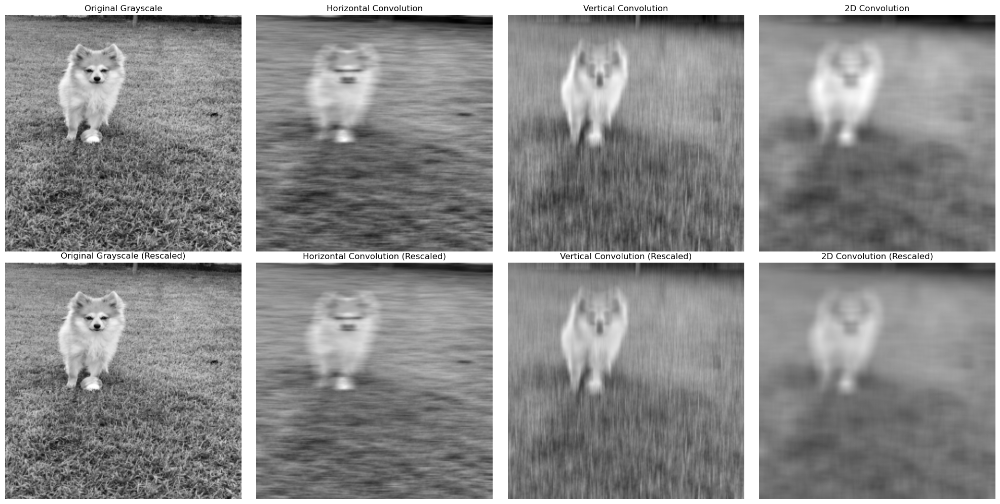

In [35]:
# Your solution

import matplotlib.pyplot as plt

# Create figure with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(20, 10))
ax = axes.ravel()

# List of titles to display
titles = ["Original Grayscale", "Horizontal Convolution", "Vertical Convolution", "2D Convolution",
         "Original Grayscale (Rescaled)", "Horizontal Convolution (Rescaled)", "Vertical Convolution (Rescaled)", "2D Convolution (Rescaled)"]

# List of images to display
images = [rocki_gray, rocki_conv_h, rocki_conv_v, rocki_conv_2d,
          rocki_gray, rocki_conv_h, rocki_conv_v, rocki_conv_2d]

# Display first row without rescaling
for i in range(4):
    ax[i].imshow(images[i], cmap=plt.cm.gray)
    ax[i].set_title(titles[i])
    ax[i].axis('off')

# Display second row with explicit pixel value rescaling (0-1)
for i in range(4, 8):
    ax[i].imshow(images[i], cmap=plt.cm.gray, vmin=0, vmax=1)
    ax[i].set_title(titles[i])
    ax[i].axis('off')

# Tight layout to reduce whitespace
plt.tight_layout()
plt.show()

c) Can we convolve a color (RGB) image? 

Implement a function `conv_coor(image, mask)` that applies a 3-channel filter.  Reshape the original `rocki.png` image to $256x256$ pixels and try your funcion, using a 15x15 uniform mask.


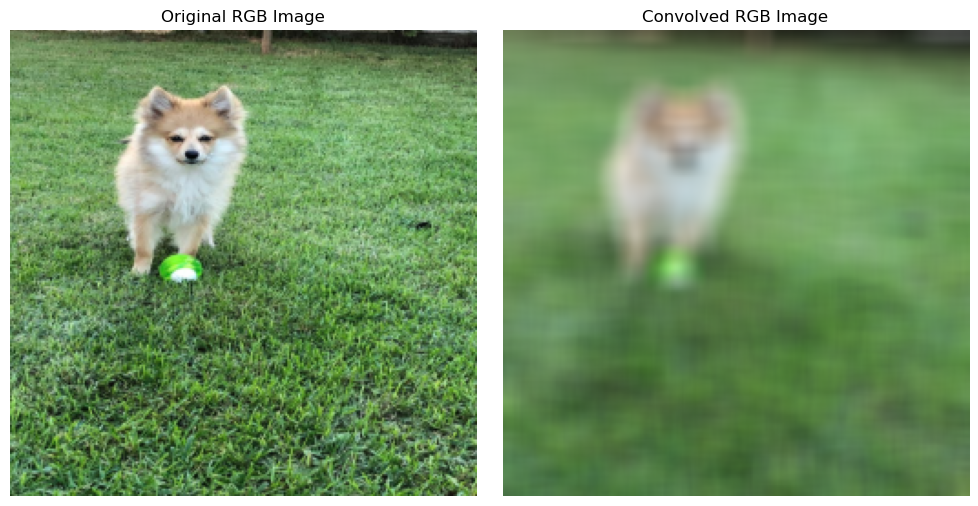

In [36]:
# Your solution

from scipy import ndimage

def conv_color(image, mask):
    """
    Apply a 3-channel filter to an RGB image.
    
    Parameters:
    - image: 3D array representing the RGB image.
    - mask: 3D array representing the 3-channel filter.
    
    Returns:
    - convolved_image: 3D array representing the convolved RGB image.
    """
    # Initialize an empty array for the convolved image.
    convolved_image = np.empty_like(image)
    
    # Apply convolution on each channel separately.
    for channel in range(3):
        convolved_image[:,:,channel] = ndimage.convolve(image[:,:,channel], mask[:,:,channel])
    
    return convolved_image

# Reshape the rocki.png image
rocki_resized = resize(rocki, (256, 256))

# Create a 15x15 uniform mask for each channel (R, G, B).
mask_3d = np.ones((15, 15, 3))
mask_3d = mask_3d / mask_3d.sum(axis=(0,1))  # Normalize for each channel

# Apply the 3-channel filter on the resized RGB image.
rocki_convolved = conv_color(rocki_resized, mask_3d)

# Display the original and convolved images.
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

ax1.imshow(rocki_resized)
ax1.set_title("Original RGB Image")
ax1.axis('off')

ax2.imshow(rocki_convolved)
ax2.set_title("Convolved RGB Image")
ax2.axis('off')

plt.tight_layout()
plt.show()


### 2.3 Effect of image scale on convolutions

a) Resize an image and observe the variations in the histograms.

1. Reduce `rocki_gray` 10 times, and check the histogram (i.e. nbins = 32)
2. Augment `rocki_gray` 10 times, and check its histogram (i.e. nbins = 32)

Is there any difference? Please, comment what happens and why.


# Answer to the question

Yes, there is a significant difference.

**1. Reducing 'rocky_gray' 10 times ('rocki_gray01'):**

When the image is reduced in size, many pixel values get combined/averaged to form the new pixel values. This results in a histogram that's smoother, with less granularity and fewer peaks, compared to the original image's histogram.

**2. Augmenting 'rocki_gray' 10 times ('rocki_gray10'):**

When the image is enlarged, the number of pixels increases, but the overall range of pixel values doesn't significantly change.

Basically, the histograms of both resized images will differ from the original image and from each other. This difference is because the process of rescaling alters the distribution of pixel values.

Original shape: (256, 256)
Shape after scaling by 10: (2560, 2560)
Shape after scaling by 0.1: (26, 26)


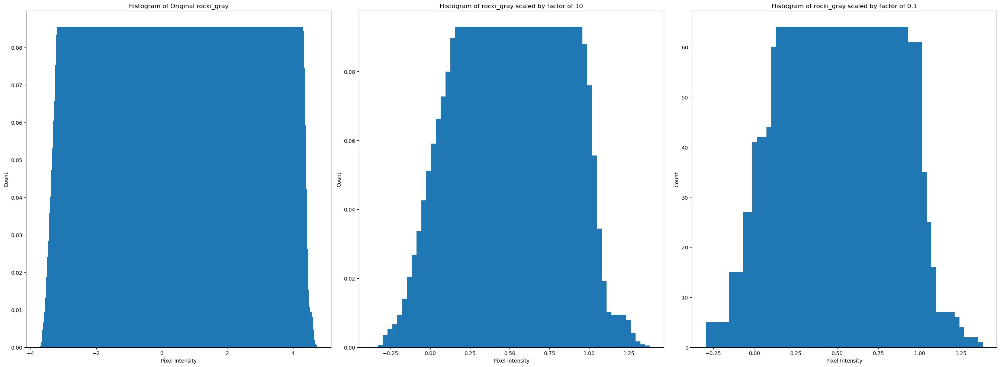

In [37]:
# Your solution

from skimage.exposure import histogram
from skimage import img_as_float
from skimage.transform import rescale
from matplotlib import pyplot as plt

# We use anti_alising=False to avoid blurring the image, which would affect the histogram
# Augment the image 10 times
rocki_gray10 = rescale(rocki_gray, 10, anti_aliasing=False)

# Reduce the image 10 times
rocki_gray01 = rescale(rocki_gray, 0.1, anti_aliasing=False)

# Print the shapes of the images
print("Original shape:", rocki_gray.shape)
print("Shape after scaling by 10:", rocki_gray10.shape)
print("Shape after scaling by 0.1:", rocki_gray01.shape)

hst_original = histogram(rocki_gray, nbins=32, source_range='image', normalize=True)
hst10 = histogram(rocki_gray10, nbins=32, source_range='image', normalize=True)
hst01 = histogram(rocki_gray01, nbins=32, source_range='image', normalize=False)

fig = plt.figure(figsize=(27, 10))

# Original histogram
fig.add_subplot(1, 3, 1)
plt.bar(hst_original[1], hst_original[0], width=7.5)
plt.title("Histogram of Original rocki_gray")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

# Histogram of image scaled by a factor of 10
fig.add_subplot(1, 3, 2)
plt.bar(hst10[1], hst10[0])
plt.title("Histogram of rocki_gray scaled by factor of 10")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

# Histogram of image scaled by a factor of 0.1
fig.add_subplot(1, 3, 3)
plt.bar(hst01[1], hst01[0])
plt.title("Histogram of rocki_gray scaled by factor of 0.1")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

plt.tight_layout()
plt.show()

b) Apply a convolution (15x15 uniform mask) on the resized images, calculate the histograms and compare the results.

1. Convolve the original `rocki_gray` image and calculate its histogram.
2. Convolve the reduced `rocki_gray` image 10 times and calculate its histogram.
3. Convolve the augmented `rocki_gray` image 10 times and calculate its histogram.

Comment what happens and why.

# Answer the question

Convolution using a 15x15 uniform mask essentially means we're applying a local averaging filter to the image. Here's what happens:

- **Convolved Original Image**: Convolution with a uniform mask acts like a smoothing operation, which reduces sharp variations or noise in the image. As a result, the histogram might show fewer high-frequency changes in pixel values, resulting in a smoother histogram.

- **Convolved Reduced Image**: Since the reduced image has lost a lot of original detail, its histogram will likely be smoother than the original. After convolution, further smoothing occurs, which can lead to an even simpler histogram with fewer peaks.

- **Convolved Augmented Image**: The augmented image has many more pixels, but those pixels were generated via interpolation from the original image. Convolution will smooth out any artifacts or noise introduced during the augmentation, but the histogram will be somewhat similar to the histogram of the convolved original image, albeit with a wider spread due to the larger image size.

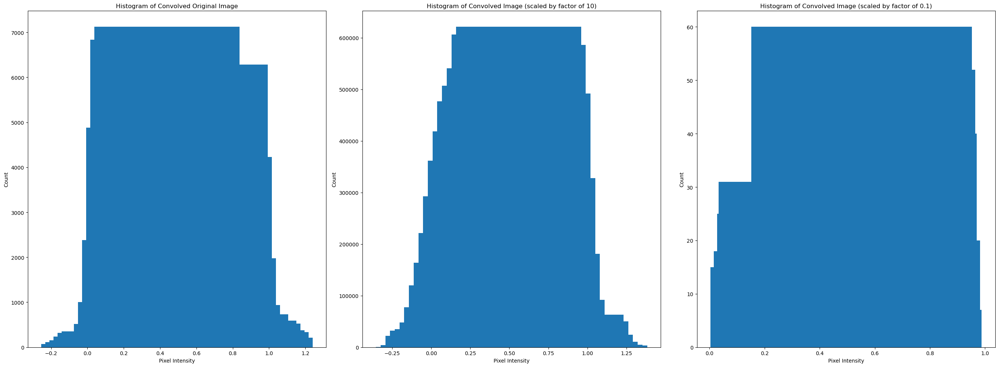

In [38]:
# Your solution

from scipy.ndimage import convolve

# Define the 15x15 uniform mask and normalize it
mask = np.ones((15, 15))
mask = mask / mask.sum() # Normalize

# Apply convolution
conv_original = convolve(rocki_gray, mask)
conv_rocki_gray10 = convolve(rocki_gray10, mask)
conv_rocki_gray01 = convolve(rocki_gray01, mask)

# Calculate histograms
hst_conv_original = histogram(conv_original, nbins=32)
hst_conv_rocki_gray10 = histogram(conv_rocki_gray10, nbins=32)
hst_conv_rocki_gray01 = histogram(conv_rocki_gray01, nbins=32)

# Plot histograms
fig = plt.figure(figsize=(27, 10))

# Histogram of convolved original image
fig.add_subplot(1, 3, 1)
plt.bar(hst_conv_original[1], hst_conv_original[0])
plt.title("Histogram of Convolved Original Image")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

# Histogram of convolved image scaled by a factor of 10
fig.add_subplot(1, 3, 2)
plt.bar(hst_conv_rocki_gray10[1], hst_conv_rocki_gray10[0])
plt.title("Histogram of Convolved Image (scaled by factor of 10)")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

# Histogram of convolved image scaled by a factor of 0.1
fig.add_subplot(1, 3, 3)
plt.bar(hst_conv_rocki_gray01[1], hst_conv_rocki_gray01[0])
plt.title("Histogram of Convolved Image (scaled by factor of 0.1)")
plt.xlabel("Pixel Intensity")
plt.ylabel("Count")

plt.tight_layout()
plt.show()

### 2.4 Image processing with weighting and non-linear filters

a) Generate the following kernels and apply them to the `rocki_gray` image:

1. Gaussian kernel with sigma = 1
2. Gaussian kernel with a different sigma value. Which is the most adequate value for keeping the main objects and structures of the image?
3. Median filter.

Comment the effect of using different kinds of filters on the original image.

**Hint:** Search for the [skimage.filters function](https://scikit-image.org/docs/stable/api/skimage.filters.html) for creating the different filters.

# Answer to the questions

Gaussian filters are great for general blurring and noise reduction. The sigma value determines the extent of blurring: higher sigma values produce more blur. The choice of sigma value depends on the application. For keeping the main objects and structures of the image recognizable, sigma=1 appears to be a good choice. However, if the goal is to highlight major structures and eliminate finer details, a higher sigma value like sigma=3 can be used.

Median filters are excellent for removing certain types of noise (like salt-and-pepper) and can retain edges better than Gaussian filters. However, they might not provide as smooth a result in uniform areas.

The choice of filter and its parameters depends on the specific needs of the image processing task. If the goal is noise reduction while preserving edges, a median filter might be more suitable. If general blurring or removing finer details is the objective, a Gaussian filter with an appropriate sigma value can be used.

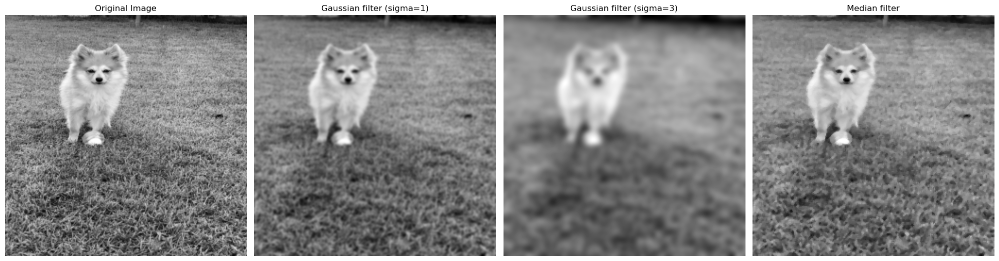

In [39]:
# Your solution

from skimage.filters import gaussian
from skimage.filters import median
import matplotlib.pyplot as plt

# Applying Gaussian filter with sigma = 1
rocki_gaussian1 = gaussian(rocki_gray, sigma=1)

# Applying Gaussian filter with sigma = 3
rocki_gaussian3 = gaussian(rocki_gray, sigma=3)

# Applying Median filter 
rocki_median = median(rocki_gray)

fig, axes = plt.subplots(1, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(rocki_gray, cmap=plt.cm.gray)
ax[0].set_title('Original Image')
ax[1].imshow(rocki_gaussian1, cmap=plt.cm.gray)
ax[1].set_title('Gaussian filter (sigma=1)')
ax[2].imshow(rocki_gaussian3, cmap=plt.cm.gray)
ax[2].set_title('Gaussian filter (sigma=3)')
ax[3].imshow(rocki_median, cmap=plt.cm.gray)
ax[3].set_title('Median filter')

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

b) **(Optional)** Apply the smoothing on some other images and present their results.

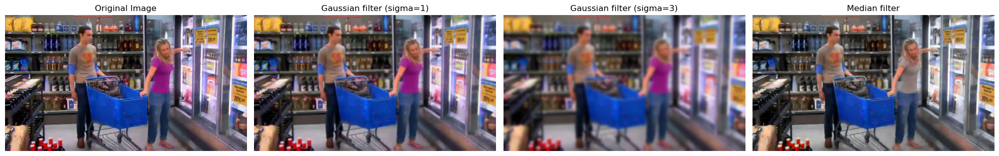

In [40]:
# Your solution

from skimage.filters import gaussian
from skimage.filters import median
import matplotlib.pyplot as plt

# Read another image called frame00020.png
frame = imread('./images_notebook/bigbangcollection/frame00020.png')

# Applying Gaussian filter with sigma = 1
frame_gaussian1 = gaussian(frame, sigma=1, channel_axis=-1) # channel_axis=-1 to silence a warning

# Applying Gaussian filter with sigma = 3
frame_gaussian3 = gaussian(frame, sigma=3, channel_axis=-1)

# Applying Median filter 
frame_median = median(frame)

fig, axes = plt.subplots(1, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(frame, cmap=plt.cm.gray)
ax[0].set_title('Original Image')
ax[1].imshow(frame_gaussian1, cmap=plt.cm.gray)
ax[1].set_title('Gaussian filter (sigma=1)')
ax[2].imshow(frame_gaussian3, cmap=plt.cm.gray)
ax[2].set_title('Gaussian filter (sigma=3)')
ax[3].imshow(frame_median, cmap=plt.cm.gray)
ax[3].set_title('Median filter')

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

### 2.5 Determine the optimal contour 

a) Load the 'logo.png' image and visualize its contours.	

<img src="images_notebook/logo.png" width="400" height="400">


Apply the different contour extraction tecniques introduced during the theory session and change any parameter if necessary for detecting the edges of the image:

1. Prewitt
2. Sobel
3. Canny

Use subplot and title to visualize the results.

#### **Questions**

- Which is the best countour detection technique? 

- Which are the optimal parameters for this image? 

- Is it necessary to normalize the mask as we do in the filtering applied for the smoothing? 

**Hint**: use `skimage.feature.canny` for applying the canny filter and `skimage.filters` for the rest.

**(Optional)** Superimpose the contours over the image.

# Answers to the questions

**1. Which is the best countour detection technique?**

Based on the results we got:

1. **Prewitt**: The contours are quite prominent, especially around the central figure and the text. However, it appears to have detected some noise, especially in the darker parts of the image (the black background).

2. **Sobel**: The contours seem smoother and more continuous compared to Prewitt. The text and the central figure are well defined, and there is lesser noise in the darker parts than in the Prewitt image.

3. **Canny**: This provides very clear and thin contours. The text, the central figure, and even the smaller details like the stars are distinctly visible. The background remains mostly noise-free.

The Canny method appears to be the best contour detection technique for this image. It provides thin, distinct, and connected contours while minimizing noise in the background. The edges are sharp, and the finer details are well captured, which makes it especially suitable for logos or any other images where precision is essential.

**2.Which are the optimal parameters for this image?**

The optimal parameters, especially for the Canny edge detection, depend on the image.

- For Canny, the sigma parameter affects the smoothing applied to the image and can influence the edges detected. The optimal value would need testing based on the specific details and noise level of the image. A higher sigma might capture broader features, while a lower one might capture finer details.

- For Prewitt and Sobel, there aren't parameters to change in their basic implementation through skimage.

For the best results, we would need to experiment with different values, especially for Canny's sigma, and choose the one that visually gives the best edge detection for our specific image.

**3. Is it necessary to normalize the mask as we do in the filtering applied for the smoothing?**

No, for the contour detection methods provided by skimage, normalization of the mask (or kernel) isn't necessary. The methods internally handle any required normalization. However, if we were implementing these methods from scratch or using raw convolution operations, we'd need to ensure the mask is normalized to prevent changing the overall brightness of the image.

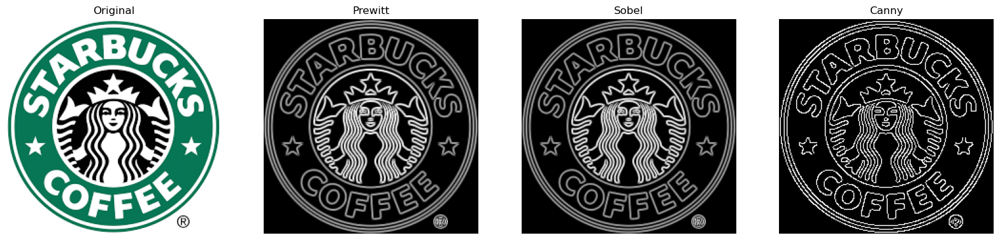

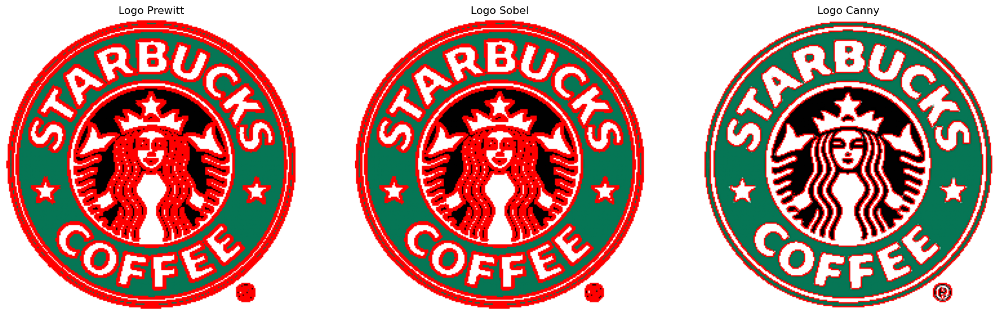

In [41]:
import warnings
warnings.filterwarnings("ignore")

from skimage import io, color, filters, feature
from skimage.color import rgb2gray, rgba2rgb

"""Your Solution"""

# Function to show contours using different techniques
def show_contours(imagergb, canny_sigma=1):  # Adjusted default sigma for Canny
    """
    This function visualizes the edges of the given image using Prewitt, Sobel, and Canny techniques.
    
    Parameters:
    - imagergb: RGB image input.
    - canny_sigma: Sigma parameter for Canny edge detection.
    
    Returns:
    - Prewitt, Sobel, and Canny edge detected images.
    """
    # Convert the RGB image to grayscale for edge detection
    gray_image = rgb2gray(imagergb)
    
    # Apply edge detection techniques
    image_prewitt = filters.prewitt(gray_image)
    image_sobel = filters.sobel(gray_image)
    image_canny = feature.canny(gray_image, canny_sigma)

    # Visualize the results
    fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(20,8))
    axs[0].imshow(imagergb)
    axs[0].axis('off')
    axs[0].set_title('Original')

    axs[1].imshow(image_prewitt, cmap='gray')
    axs[1].axis('off')
    axs[1].set_title('Prewitt')

    axs[2].imshow(image_sobel, cmap='gray')
    axs[2].axis('off')
    axs[2].set_title('Sobel')

    axs[3].imshow(image_canny, cmap='gray')
    axs[3].axis('off')
    axs[3].set_title('Canny')
    plt.show()

    return image_prewitt, image_sobel, image_canny

# Function to superimpose contours on the base image
def superpose_contours(base, contour, redvalue):
    """
    This function superimposes the contour of a given technique on the original image.
    
    Parameters:
    - base: Original image.
    - contour: Edge detected image.
    - redvalue: Intensity of red color for superimposition.
    
    Returns:
    - Image with superimposed contours.
    """
    # Ensure both the base and contour are of the same shape
    assert base.shape[:2] == contour.shape, "Mismatched dimensions between base and contour"
    
    # Copy the original image to avoid in-place modifications
    superimposed = base.copy()

    # Define a threshold for superimposing
    threshold = 0.1
    superimposed[contour > threshold] = [redvalue, 0, 0]  # Setting the pixel value to red where the contour is detected

    return superimposed

# Load the image
logo = rgba2rgb(io.imread('./images_notebook/logo.png'))

# Display contours using the three techniques
logo_prewitt, logo_sobel, logo_canny = show_contours(logo)

# Superimpose the contours on the original image and visualize
fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(20,8))
axs[0].imshow(superpose_contours(logo, logo_prewitt, 1))
axs[0].axis('off')
axs[0].set_title('Logo Prewitt')

axs[1].imshow(superpose_contours(logo, logo_sobel, 1))
axs[1].axis('off')
axs[1].set_title('Logo Sobel')

axs[2].imshow(superpose_contours(logo, logo_canny, 1))
axs[2].axis('off')
axs[2].set_title('Logo Canny')

plt.show()

b)	Repeat the experiment with other images, you can use the ones included in the folder **images**. Comment if some parameter needs to be changed for the different images.

#### **Questions**

- Are the contours improved if the image is previously smoothed? 
- Which are the limitations of the different images contour extraction?

# Answers to the questions

**1.Are the contours improved if the image is previously smoothed?**

Yes, the contours appear to be improved after the image is smoothed (We tested with a Gaussian blur). The smoothed versions show fewer noisy detections. For instance, in the smoothed versions, the red superimposed contour lines are less scattered, especially in the background areas. This suggests that smoothing effectively reduces the high-frequency noise in the image, which in turn provides cleaner contour extraction results.

**2.Which are the limitations of the different images contour extraction?**

- Prewitt and Sobel Operators: Both the Prewitt and Sobel edge detectors are based on gradient methods. The limitations include:
1. Sensitive to noise: As seen in the unsmoothed images, both the Prewitt and Sobel operators detected numerous unnecessary contours in the background and on the dog, indicating sensitivity to noise. Smoothing helps with this limitation.
2. Thickness of the edges: The detected edges can be broad and not as precise.
3. Not adaptive: They don't adapt to changes in image characteristics or content, meaning they might not always provide optimal results for all types of images.

- Canny Edge Detector: Canny is more sophisticated than Prewitt and Sobel and generally provides better results. Its limitations include:
1. Sensitive to the sigma parameter: The results can vary significantly based on the chosen sigma value. This might require fine-tuning based on the specific image.
2. Still some noise: Even though Canny generally reduces more noise than Prewitt or Sobel, some noisy contours are still visible in the background in the unsmoothed version. However, it performs significantly better after smoothing.
3. Complexity: Canny is more computationally intensive than the other two methods.

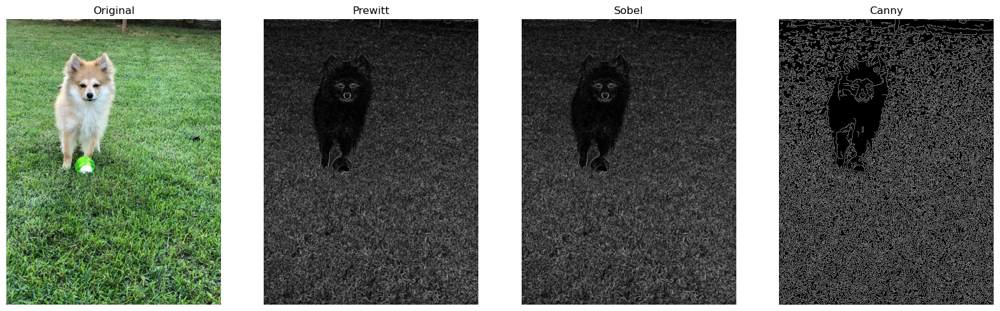

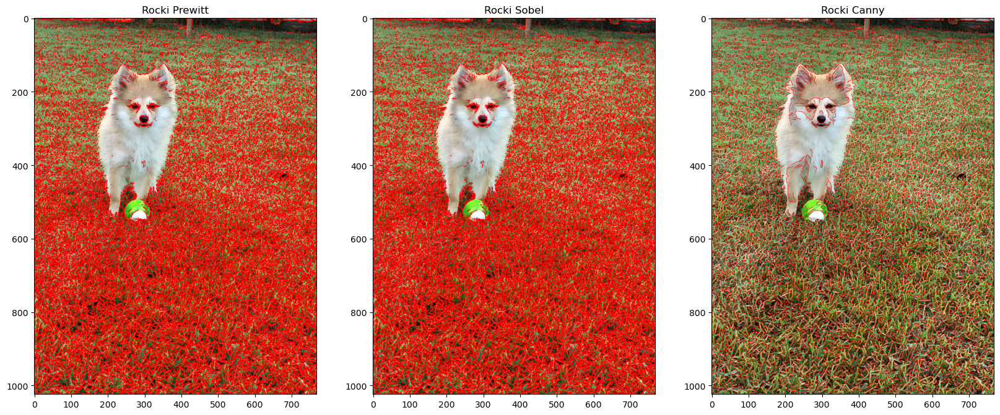

Contours on smoothed image:


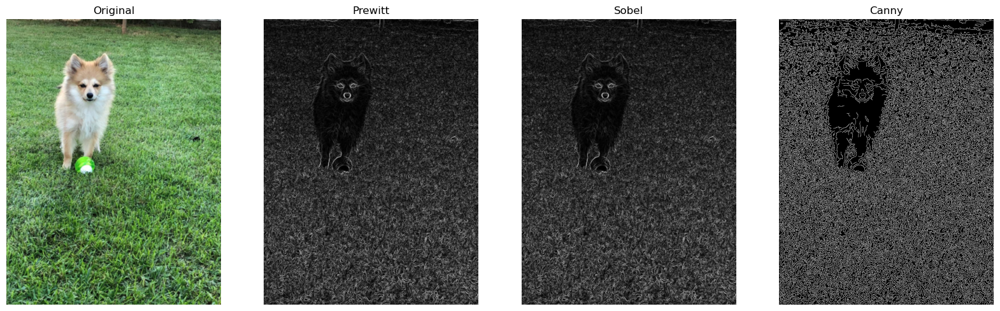

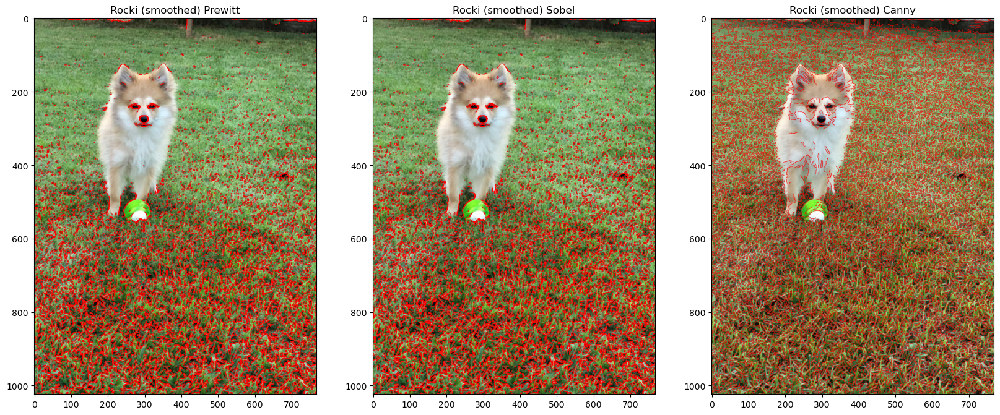

In [42]:
# Your solution

from skimage.filters import gaussian

# Function to apply Gaussian blur
def smooth_image(image, sigma=1):
    return gaussian(image, sigma=sigma)

# Load the image
image = io.imread('images_notebook/rocki.jpeg')

# Display contours using the three techniques
image_prewitt,image_sobel,image_canny = show_contours(image,canny_sigma=1.7)

# Superimpose the contours on the original image and visualize
fig, axs = plt.subplots(ncols=3, nrows=1,figsize=(20,8))
ax = axs[0]
ax.imshow(superpose_contours(image, image_prewitt,255))
ax.set_title('Rocki Prewitt')
ax = axs[1]
ax.imshow(superpose_contours(image, image_sobel,255))
ax.set_title('Rocki Sobel')
ax = axs[2]
ax.imshow(superpose_contours(image, image_canny,255))
ax.set_title('Rocki Canny')

plt.show()

# Apply Gaussian blur to the image
smoothed_image = smooth_image(image, sigma=1)

# Display contours using the three techniques on the smoothed image
print("Contours on smoothed image:")
image_prewitt, image_sobel, image_canny = show_contours(smoothed_image, canny_sigma=1)

# Superimpose the contours on the original (smoothed) image and visualize
fig, axs = plt.subplots(ncols=3, nrows=1,figsize=(20,8))
ax = axs[0]
ax.imshow(superpose_contours(smoothed_image, image_prewitt, 1))
ax.set_title('Rocki (smoothed) Prewitt')
ax = axs[1]
ax.imshow(superpose_contours(smoothed_image, image_sobel, 1))
ax.set_title('Rocki (smoothed) Sobel')
ax = axs[2]
ax.imshow(superpose_contours(smoothed_image, image_canny, 1))
ax.set_title('Rocki (smoothed) Canny')

plt.show()

c) How many different ways can the Sobel detector be applied? Apply it (in all possible ways), and visualize and compare the obtained results.


# Answer to the question

We can apply it with three different methods:
1. Applying the Sobel filter with the skimage library.
2. Applying the Sobel mask for horizontal gradient contour checking.
3. Applying the Sobel mask for vertical gradient contour checking.

In the first image we can see the horizontal contours, in the second image the vertical ones, and in the last one,
the sum of both.

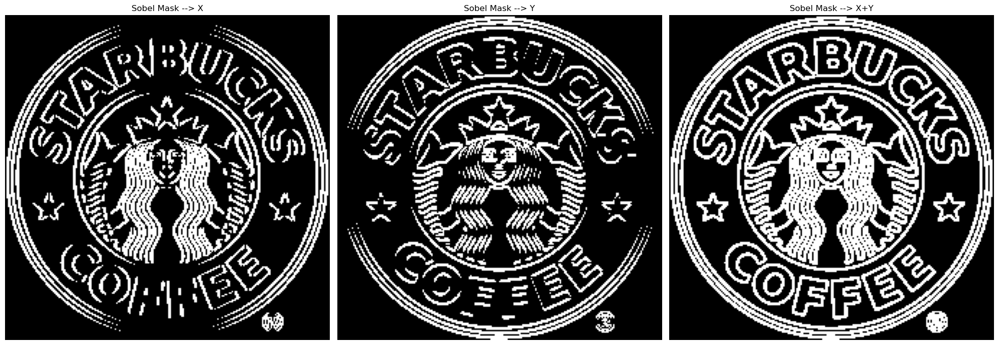

In [43]:
# Your solution

# In order to convolve a RBG image we found a python function that applies the mask to each channel separately.
from skimage.color.adapt_rgb import adapt_rgb, each_channel

@adapt_rgb(each_channel)
def convolve_3_channels(image, mask):
    return convolve(image, mask)

# Define the Sobel mask for the X direction
maskX = np.array([[-1,0,1], [-2,0,2], [-1,0,1]])

# Apply the Sobel mask for the X direction to the grayscale image
sobelX = convolve_3_channels(rgb2gray(logo.copy()), maskX)

# Apply the Sobel mask for the Y direction (which is the transpose of the X direction mask) to the grayscale image
sobelY = convolve_3_channels(rgb2gray(logo.copy()), maskX.T)

# Create a 1x3 subplot to display the results of the Sobel operator in the X and Y directions, as well as their combination
f, axarr = plt.subplots(ncols=3, nrows=1, figsize=(20,8))

# Display the result of applying the Sobel mask in the X direction (with a threshold of 0.9 to only show the contours)
axarr[0].imshow(abs(sobelX) > 0.9, cmap='gray')
axarr[0].set_title('Sobel Mask --> X')
axarr[0].axis('off')

# Display the result of applying the Sobel mask in the Y direction (with a threshold of 0.9 to only show the contours)
axarr[1].imshow(abs(sobelY) > 0.9, cmap='gray')
axarr[1].set_title('Sobel Mask --> Y')
axarr[1].axis('off')

# Display the combined result of applying the Sobel mask in both X and Y directions (with a threshold of 0.9 to only show the contours)
axarr[2].imshow(abs(sobelX) + abs(sobelY) > 0.9, cmap='gray')
axarr[2].set_title('Sobel Mask --> X+Y')
axarr[2].axis('off')

# Display the plots
plt.tight_layout()  # Adjust layout for better appearance
plt.show()

### 2.6 Applying smoothing in order to obtain hybrid images

a) Given `./images_notebook/Capitain_America.jpg` and `./images_notebook/Ironman.jpg` images:

1. Plot both images.
2. Apply a low-pass filter to both of them and plot them.
3. Apply a high-pass filter to both of them and plot them.

The result should be something like:

<img src="images_notebook/Capitain.png" width="800" height="800">
<img src="images_notebook/Ironman.png" width="800" height="800">


By applying smoothing over an image I, we apply a `low-pass` filter. The resulting image can be called L(I). If we substract the filtered one from the original image, we obtain its high frequencies, that we can call H(I), i.e. we apply a `high-pass` filter. 

***H(I) = I - L(I)***

Hint: In order to highlight the effect, in the L(I) image you should define a lower sigma, while for the H(I) you should use a higher one. 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


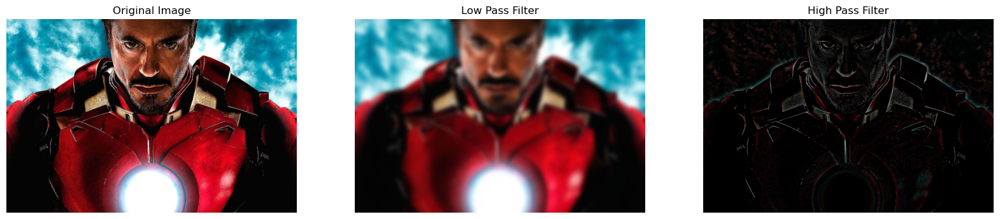

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


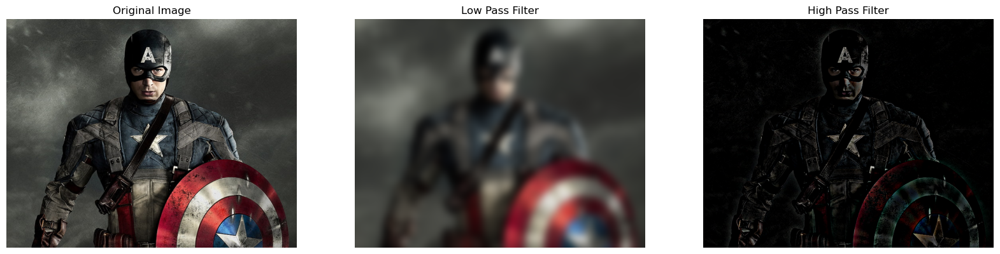

In [44]:
# Your solution
import matplotlib.pyplot as plt
from skimage import filters, io, img_as_float

def apply_filters(image, lp_sigma=10):
    """
    Applies low-pass and high-pass filters to the input image.

    Args:
    - image (ndarray): Input image.
    - lp_sigma (float): Sigma value for the low-pass filter.

    Returns:
    - low_pass (ndarray): Image after applying low-pass filter.
    - high_pass (ndarray): Image after applying high-pass filter.
    """
    image_float = img_as_float(image)
    low_pass = filters.gaussian(image_float, lp_sigma)
    high_pass = image_float - low_pass
    return low_pass, high_pass

def plot_images(original, low_pass, high_pass):
    """
    Plots the original, low-pass filtered, and high-pass filtered images side by side.

    Args:
    - original (ndarray): Original image.
    - low_pass (ndarray): Image after applying low-pass filter.
    - high_pass (ndarray): Image after applying high-pass filter.
    """
    _, axarr = plt.subplots(ncols=3, figsize=(20, 8))
    axarr[0].imshow(original, cmap='gray')
    axarr[0].set_title('Original Image')
    axarr[0].axis('off')

    axarr[1].imshow(low_pass, cmap='gray')
    axarr[1].set_title('Low Pass Filter')
    axarr[1].axis('off')

    axarr[2].imshow(high_pass, cmap='gray')
    axarr[2].set_title('High Pass Filter')
    axarr[2].axis('off')

    plt.show()

# Process and plot for Ironman
ironman = io.imread('./images_notebook/Ironman.jpg')
ironman_lp, ironman_hp = apply_filters(ironman)
plot_images(ironman, ironman_lp, ironman_hp)

# Process and plot for Captain America
captain = io.imread('./images_notebook/Capitain_America.jpg')
captain_lp, captain_hp = apply_filters(captain)
plot_images(captain, captain_lp, captain_hp)


b) Create hybrid images and visualize them. A hybrid image is obtained by combining the low and high frequencies of the image, i.e. combining the results obtained by the `low-pass` and `high-pass` filters.

<img src="images_notebook/Fusion.gif" width="400" height="400">

Hybrid (I1, I2) = L(I1) + H(I2)

1. Analyze which is the best way of showing it if our aim is to see the Ironman face. 
2. Additionally, rescale the image to a different size and comment the results. 

Present the different visualizations of the experiment performed.

<img src="images_notebook/Hybrid.png" width="800" height="800">


# Answer to the questions

1. **Analyze which is the best way of showing it if our aim is to see the Ironman face.**

    From the images we obtained (before reescaling):

    The first image ("low_ironman + high_captain") retains the low-frequency features (the larger, broader details) from Ironman and the high-frequency features (the finer details, like edges) from Captain America.

    The second image ("high_ironman + low_captain") takes the high-frequency features from Ironman and the low-frequency features from Captain America.
    
    If our aim is to predominantly see Ironman's face, then the "high_ironman + low_captain" image is the more suitable option. Although some people would say that "low_ironman + high_captain" is better, this is because our eyes are more attuned to recognizing faces based on their broader details (like overall face shape, positioning of the eyes, nose, and mouth) which are captured in the low-frequency components. The high-frequency components, while offering sharper edges, don't define the face as well as the low-frequency components do.

2. **Additionally, rescale the image to a different size and comment the results.**

    When we rescale a hybrid image, particularly when you reduce its size, the low-frequency details tend to become less apparent, and the high-frequency details stand out more. This is due to the fact that as we decrease the image size, the broad details (low frequencies) are condensed, while the sharper, finer details (high frequencies) become relatively more pronounced.

    So, if we were to shrink the "low_ironman + high_captain" image, Captain America's features (the high-frequency details) would become more dominant, and it might be harder to discern Ironman's face. Conversely, if you enlarged the image, Ironman's low-frequency details would become more prominent.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


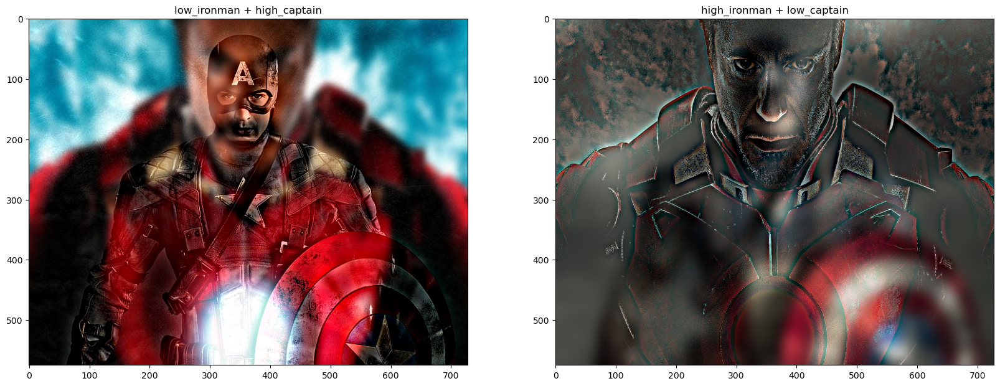

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'high_ironman + low_captain (Resized)')

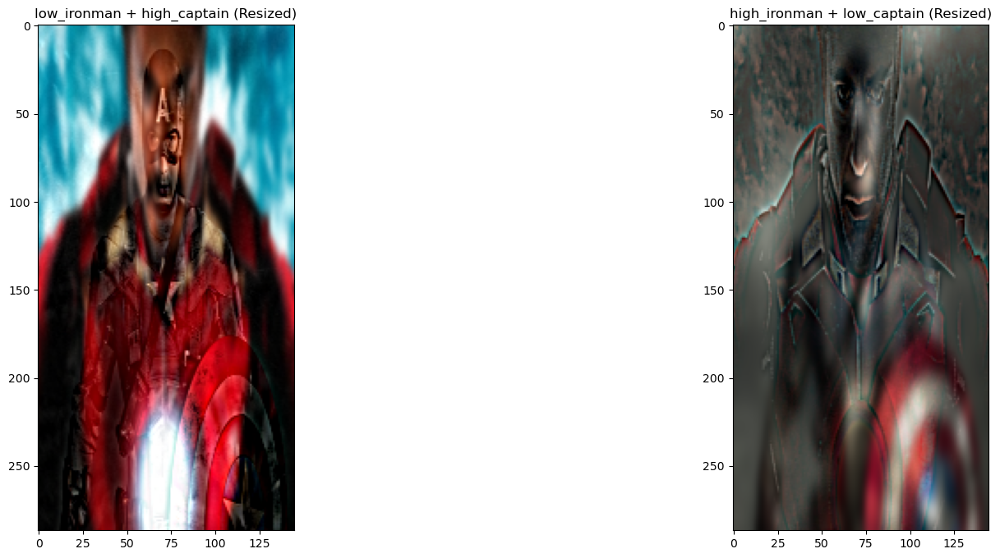

In [45]:
# Your solution

import matplotlib.pyplot as plt
from skimage import transform

def create_hybrid_image(low_pass_img, high_pass_img):
    """
    Creates a hybrid image by adding the low-pass and high-pass filtered images.

    Args:
    - low_pass_img (ndarray): Image after applying low-pass filter.
    - high_pass_img (ndarray): Image after applying high-pass filter.

    Returns:
    - ndarray: Hybrid image.
    """
    return low_pass_img + high_pass_img

def resize_and_plot(images, titles, scale_factor):
    """
    Resize the provided images by the given scale factor and then plot them.

    Args:
    - images (list): List of images to resize and plot.
    - titles (list): Titles for each of the images.
    - scale_factor (float): Factor by which to resize the images.
    """
    fig, axarr = plt.subplots(ncols=len(images), figsize=(20, 8))
    
    for i, (img, title) in enumerate(zip(images, titles)):
        # Ensure only the first 3 channels are used (RGB)
        img = img[..., :3]
        resized_img = transform.rescale(img, scale_factor, anti_aliasing=True)
        axarr[i].imshow(resized_img, cmap='gray')
        axarr[i].set_title(title)
    
    plt.show()

# Ensure both images are the same size before proceeding
# Using Captain America's image dimensions as reference
resize_shape = captain.shape
ironman_lp_resized = transform.resize(ironman_lp, resize_shape)
ironman_hp_resized = transform.resize(ironman_hp, resize_shape)

# Create hybrid images
hybrid1 = create_hybrid_image(ironman_lp_resized, captain_hp)
hybrid2 = create_hybrid_image(ironman_hp_resized, captain_lp)

# Visualize results
fig, axarr = plt.subplots(ncols=2, figsize=(20, 8))
axarr[0].imshow(hybrid1, cmap='gray')
axarr[0].set_title('low_ironman + high_captain')

axarr[1].imshow(hybrid2, cmap='gray')
axarr[1].set_title('high_ironman + low_captain')

plt.show()

# Compute the resize shape by a factor of 0.5 (y-axis), 0.2 (x-axis)
resize_shape = (int(captain.shape[0] * 0.5), int(captain.shape[1] * 0.2), 3)

ironman_lp_resized = transform.resize(ironman_lp, resize_shape)
ironman_hp_resized = transform.resize(ironman_hp, resize_shape)

captain_lp_resized = transform.resize(captain_lp, resize_shape)
captain_hp_resized = transform.resize(captain_hp, resize_shape)

# Create hybrid images
hybrid1 = create_hybrid_image(ironman_lp_resized, captain_hp_resized)
hybrid2 = create_hybrid_image(ironman_hp_resized, captain_lp_resized)

# Visualize results
fig, axarr = plt.subplots(ncols=2, figsize=(20, 8))
axarr[0].imshow(hybrid1, cmap='gray')
axarr[0].set_title('low_ironman + high_captain (Resized)')

axarr[1].imshow(hybrid2, cmap='gray')
axarr[1].set_title('high_ironman + low_captain (Resized)')

### 2.7 Anonimization of videos

One of the important problems in Computer Vision as a science that manages data (images and videos) is the anonimization of persons appearing in them. Given the collection of images in the folder collectionbigbang, smooth the images in order to make unrecognizible the faces of the persons. Display sequentially the original and the anonimized images.

Help: 

- In order to read all images from a sequence, check the type [ImageCollection](http://scikit-image.org/docs/0.7.0/api/skimage.io.collection.html).

- In order to animate a sequence of images, you can use the animation library of matplotlib (in particular, [FuncAnimation](https://matplotlib.org/api/animation_api.html)). 

Note that the animation library does not work with matplotlib inline. You should use the nbagg plugin to visualize the sequence of images. To this purpose, write before animation the following line:
% matplotlib nbagg

Note: you only need to run and understand the following code and substitute the video frames with their smoothed version, you do not need to implement anything else.

In [46]:
""""Showing one video per annimation"""
import warnings
warnings.filterwarnings("ignore")

from skimage import io, filters
import numpy as np
from skimage import transform
from matplotlib import pyplot as plt
import matplotlib.animation as animation

ic = io.ImageCollection('./images_notebook/bigbangcollection/*.png')

# Rescale to half of their size
scale = 0.5
frames = len(ic)
height = int((ic[0].shape[0]) * scale)
width = int((ic[0].shape[1]) * scale)

print('Info about the animation:')
print('Num Frames:' + str(frames))
print('Images height:' + str(height))
print('Images width:' + str(width))

# create variable with dimensions of images by the number of frames
ic_small=np.ndarray(shape=(height, width, 3, frames))

# combine them in ic_small variable
for i in range(frames):
    ic_small[:,:,:,i] = transform.rescale(ic[i], scale, channel_axis=-1)
        
print('The variable ic_small contains all rescaled images. Its shape is: ' + str(ic_small.shape))


%matplotlib nbagg

def updatefig1(i): 
    blurred_image = filters.gaussian(ic_small[:,:,:,i], sigma=4)  # Apply Gaussian filter to smooth the image
    im.set_array(blurred_image)  # Set the array to blurred image
    plt.draw()                                          
    return im,                                           

fig = plt.figure()
im = plt.imshow(ic_small[:,:,:,0])
ani = animation.FuncAnimation(fig, updatefig1, interval=2, blit=True, frames=len(ic), repeat= False)
plt.show()


Info about the animation:
Num Frames:200
Images height:180
Images width:320
The variable ic_small contains all rescaled images. Its shape is: (180, 320, 3, 200)


<IPython.core.display.Javascript object>